## Week 7,

Febrian Dani | 2141720070 | 3H

In [11]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Praktikum


In [12]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import math
from google.colab.patches import cv2_imshow
from PIL import Image as im

1. Sharpen

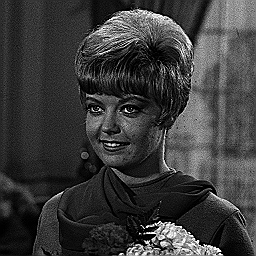

In [14]:
def convolution2d(image, kernel):
    tinggi = image.shape[0]
    lebar = image.shape[1]

    tinggi_kernel = kernel.shape[0]
    lebar_kernel = kernel.shape[1]

    start = int(lebar_kernel/2)

    image_result = np.copy(image)

    for y in range(start, tinggi - start):
        for x in range(start, lebar - start):
            value = 0

            for ky in range(tinggi_kernel):
                for kx in range(lebar_kernel):
                    i = y - start + ky
                    j = x - start + kx

                    value += image[i, j] * kernel[ky, kx]

            image_result[y, x] = np.clip(value, 0, 255)

    return image_result

img = cv.imread('/content/drive/My Drive/PCVK/Week3/female.tiff')
img_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# Image Sharpen
kernel_sharpen = np.array([[0, -1, 0],
                          [-1, 5, -1],
                          [0, -1, 0]])

result_image = convolution2d(img_gray, kernel_sharpen)
cv2_imshow(result_image)

2. Emboss

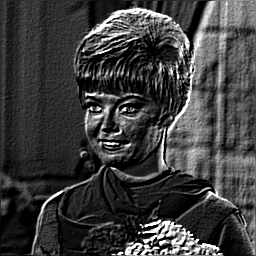

In [4]:
emboss_sharpen = np.array([[-2, -1, 0],
                          [-1, 1, 1],
                          [0, 1, 2]])

result_image = convolution2d(img_gray, emboss_sharpen)
cv2_imshow(result_image)

3. Left Sobel Edge Detection

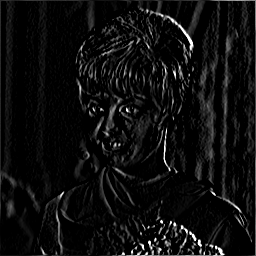

In [5]:
left_sobel_edge_detection_sharpen = np.array([[1, 0, -1],
                                              [2, 0, -2],
                                              [1, 0, -1]])

result_image = convolution2d(img_gray, left_sobel_edge_detection_sharpen)
cv2_imshow(result_image)

4. Canny Edge Detection

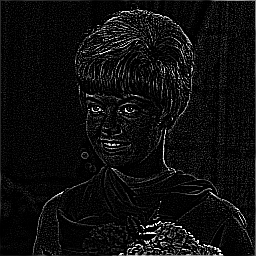

In [6]:
canny_edge_detection_sharpen = np.array([[-1, -1, -1],
                                        [-1, 8, -1],
                                        [-1, -1, -1]])

result_image = convolution2d(img_gray, canny_edge_detection_sharpen)
cv2_imshow(result_image)

5. Prewitt Edge Detection

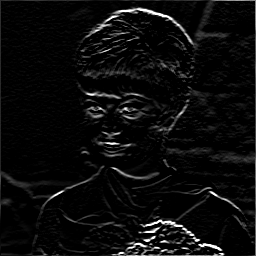

In [7]:
prewitt_edge_detection_sharpen = np.array([[-1, -1, -1],
                                          [0, 0, 0],
                                          [1, 1, 1]])

result_image = convolution2d(img_gray, prewitt_edge_detection_sharpen)
cv2_imshow(result_image)

6. 5x5 Gaussian Blur

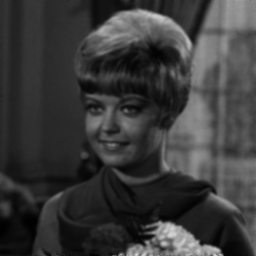

In [8]:
gaussian_blur_5_x_5 = np.array([[1, 4, 6, 4, 1],
                                [4, 16, 24, 16, 4],
                                [6, 24, 36, 24, 6],
                                [4, 16, 24, 16, 4],
                                [1, 4, 6, 4, 1]], dtype=float)

gaussian_blur_5_x_5 /= 256

result_image = convolution2d(img_gray, gaussian_blur_5_x_5)
cv2_imshow(result_image)

7. 21x21 Gaussian Blur

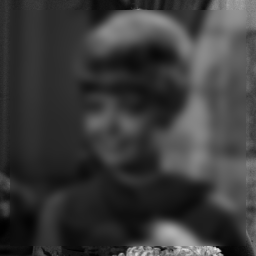

In [9]:
kernel_size = 21
sigma=math.sqrt(kernel_size)
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)
gaussian_blur_21_x_21 = gaussian_kernel @ gaussian_kernel.transpose()

result_image = convolution2d(img_gray, gaussian_blur_21_x_21)
cv2_imshow(result_image)

### Tugas
Diketahui dataset KTP dengan kondisi citra yang berbeda. Lakukan perbaikan melalui implementasi teknik filterisasi dan detection setiap citra. Terapkan juga histogram equalization dan operasi aritmatika sebagai Teknik pendukung perbaikan citra KTP.

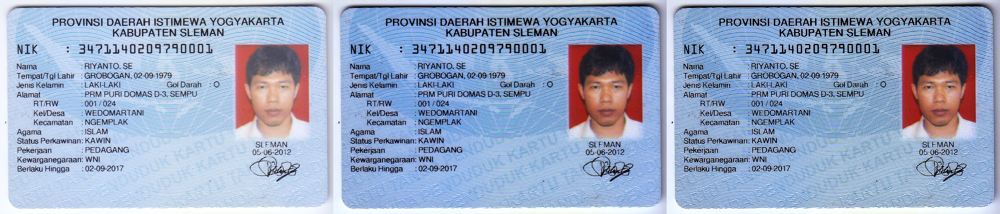

In [18]:
def gamma_correction(image, gamma):
  inv_gamma = 1 / gamma
  gamma_image = np.zeros(image.shape, image.dtype)

  # Akses per pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      for c in range(image.shape[2]):
        gamma_image[y, x, c] = np.clip((image[y, x, c] / 255) ** inv_gamma * 255, 0, 255)

  return gamma_image

def hitung_pixel(image):
  red = {}
  green = {}
  blue = {}

  # Akses per pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      b = int(image[y, x, 0])
      g = int(image[y, x, 1])
      r = int(image[y, x, 2])

      if r in red:
        red[r] += 1
      else:
        red[r] = 1

      if g in green:
        green[g] += 1
      else:
        green[g] = 1

      if b in blue:
        blue[b] += 1
      else:
        blue[b] = 1

  return red, green, blue

def histogram_equalization(image):

  # Intensitas Pixel
  intensitas_merah, intensitas_hijau, intensitas_biru = hitung_pixel(image)

  red_channel = hitung_sk(image[...,2], intensitas_merah)
  green_channel = hitung_sk(image[...,1], intensitas_hijau)
  blue_channel = hitung_sk(image[...,0], intensitas_biru)

  merged_image = cv.merge([blue_channel, green_channel, red_channel])

  return merged_image

def hitung_sk(image, list_intensitas):
  list_intensitas = dict(sorted(list_intensitas.items()))

  # l, rj dan nrj
  l = 256
  rj = list(list_intensitas.keys())
  nrj = list(list_intensitas.values())

  # K0
  k0 = []
  for i in range(len(rj)):
    if i == 0:
      k0.append(nrj[i])
    else:
      k0.append(nrj[i] + k0[i - 1])

  # Sk = round((L-1)/MAX(k0) * k0)
  sk = []
  list_pixel_baru = {}
  for i in range(len(rj)):
    k0s = (l - 1) / k0[-1] * k0[i]
    sk.append(round(k0s))

    list_pixel_baru[rj[i]] = sk[i]

  # Konversi nilai pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      image[y, x] = list_pixel_baru[image[y, x]]

  return image

kernel_sharpen = np.array([[0, -1, 0],
                          [-1, 5, -1],
                          [0, -1, 0]], dtype=np.float32)

unsharp_masking_5_x_5 = np.array([[1, 4, 6, 4, 1],
                                [4, 16, 24, 16, 4],
                                [6, 24, -476, 24, 6],
                                [4, 16, 24, 16, 4],
                                [1, 4, 6, 4, 1]], dtype=np.float32)

unsharp_masking_5_x_5 = unsharp_masking_5_x_5 * -1 / 256

ktp = cv.imread('/content/drive/MyDrive/PCVK/Week8/KTP_More/ktp.png')
ktp_copy = np.copy(ktp)
ktp_result = gamma_correction(ktp_copy, 0.5)
ktp_filtered = convolution2d(ktp_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp, ktp_result, ktp_filtered))
cv2_imshow(final_frame)

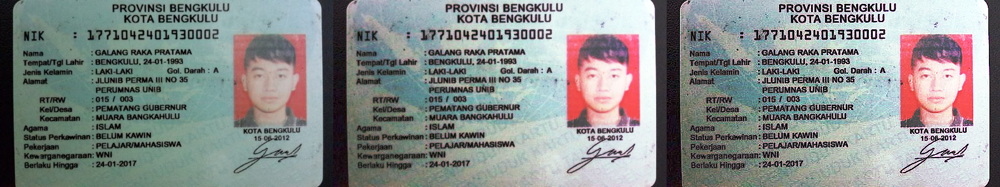

In [19]:
ktp1 = cv.imread('/content/drive/MyDrive/PCVK/Week8/KTP_More/ktp1.png')
ktp1_copy = np.copy(ktp1)
ktp1_result = histogram_equalization(ktp1_copy)
ktp1_result = gamma_correction(ktp1_result, 1.4)
ktp1_filtered = convolution2d(ktp1_result, kernel_sharpen)

final_frame = cv.hconcat((ktp1, ktp1_result, ktp1_filtered))
cv2_imshow(final_frame)

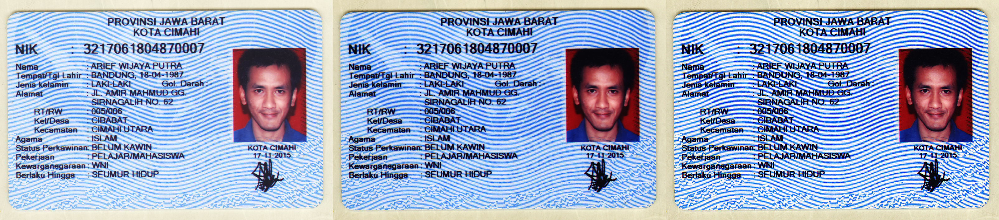

In [20]:
ktp2 = cv.imread('/content/drive/MyDrive/PCVK/Week8/KTP_More/ktp2.png')
ktp2_copy = np.copy(ktp2)
ktp2_result = gamma_correction(ktp2_copy, 0.6)
ktp2_filtered = convolution2d(ktp2_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp2, ktp2_result, ktp2_filtered))
cv2_imshow(final_frame)

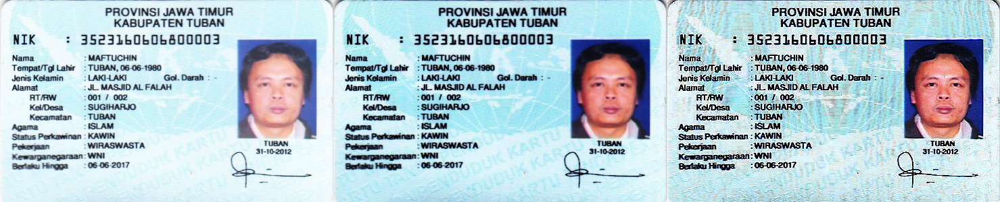

In [21]:
ktp3 = cv.imread('/content/drive/MyDrive/PCVK/Week8/KTP_More/ktp3.png')
ktp3_copy = np.copy(ktp3)
ktp3_result = gamma_correction(ktp3_copy, 0.5)
ktp3_filtered = convolution2d(ktp3_result, kernel_sharpen)

final_frame = cv.hconcat((ktp3, ktp3_result, ktp3_filtered))
cv2_imshow(final_frame)

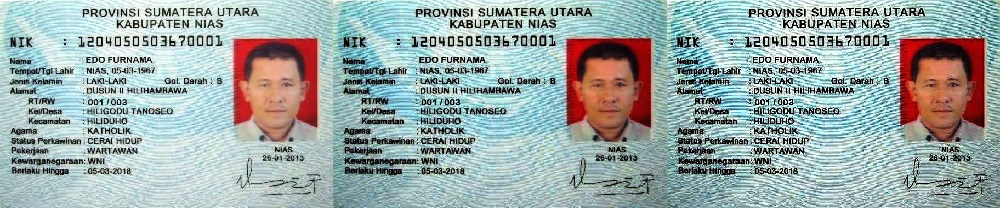

In [23]:
ktp5 = cv.imread('/content/drive/MyDrive/PCVK/Week8/KTP_More/ktp5.png')
ktp5_copy = np.copy(ktp5)
ktp5_result = gamma_correction(ktp5_copy, 0.6)
ktp5_filtered = convolution2d(ktp5_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp5, ktp5_result, ktp5_filtered))
cv2_imshow(final_frame)

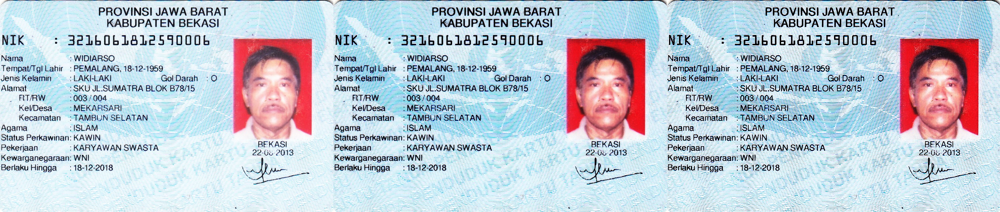

In [26]:
ktp6 = cv.imread('/content/drive/MyDrive/PCVK/Week8/KTP_More/ktp6.png')
ktp6_copy = np.copy(ktp6)
ktp6_result = gamma_correction(ktp6_copy, 0.6)
ktp6_filtered = convolution2d(ktp6_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp6, ktp6_result, ktp6_filtered))
cv2_imshow(final_frame)

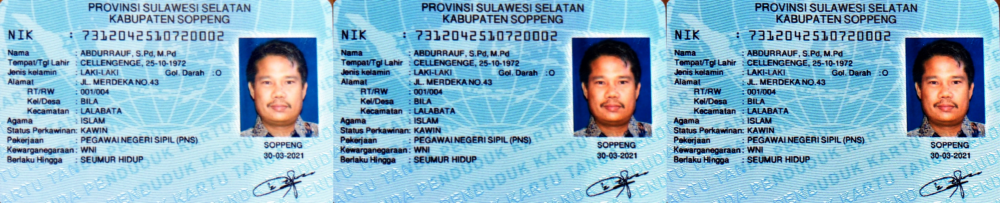

In [29]:
ktp7 = cv.imread('/content/drive/MyDrive/PCVK/Week8/KTP_More/KTP7.jpeg')
ktp7_copy = np.copy(ktp7)
ktp7_result = gamma_correction(ktp7_copy, 0.6)
ktp7_filtered = convolution2d(ktp7_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp7, ktp7_result, ktp7_filtered))
cv2_imshow(final_frame)